# Exploration - Generation Notebook

Hooking up a gradio instance running in public for 72h and hosted in google colab

link = https://df8e723941e6afce33.gradio.live/ ----- will change every time

api view = https://df8e723941e6afce33.gradio.live/?view=api -- same

In [1]:
from gradio_client import Client

client = Client("https://df8e723941e6afce33.gradio.live/")
result = client.predict(
				5,	# int | float  in 'Steps' Number component
				"Fix Seed",	# str  in 'parameter_16' Radio component
				5,	# int | float  in 'Seed' Number component
				"Fix CFG",	# str  in 'parameter_18' Radio component
				5,	# int | float  in 'Text CFG' Number component
				5,	# int | float  in 'Image CFG' Number component
				fn_index=0
)
print(result)

Loaded as API: https://df8e723941e6afce33.gradio.live/ ✔
('/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpw_7yed80.png', 'add dramatic lighting', 5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmppo_7xm21.png')


In [2]:
from gradio_client import Client

client = Client("https://df8e723941e6afce33.gradio.live/")
result = client.predict(
				"https://raw.githubusercontent.com/gradio-app/gradio/main/test/test_files/bus.png",	# str (filepath or URL to image) in 'Input Image' Image component
				"Howdy!",	# str  in 'Edit Instruction' Textbox component
				5,	# int | float  in 'Steps' Number component
				"Fix Seed",	# str  in 'parameter_16' Radio component
				5,	# int | float  in 'Seed' Number component
				"Fix CFG",	# str  in 'parameter_18' Radio component
				5,	# int | float  in 'Text CFG' Number component
				5,	# int | float  in 'Image CFG' Number component
				fn_index=1
)
print(result)


Loaded as API: https://df8e723941e6afce33.gradio.live/ ✔
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmptwbwwci4.png')


In [3]:
from gradio_client import Client

client = Client("https://df8e723941e6afce33.gradio.live/")
result = client.predict(
				fn_index=2
)
print(result)


Loaded as API: https://df8e723941e6afce33.gradio.live/ ✔
(0, 'Randomize Seed', 1371, 'Fix CFG', 7.5, 1.5, None)


---

## Automate generation with custom img -> prompt edits
1. load json with img -> prompts
2. load client google colab and gradio API
3. for each img in a folder
    1. load corresponding prompt from json
    2. generate img edit
    3. save img edit

In [11]:
import json
prompt_path = "../data/out/unplash-512-lite/000_tiny_spacewarp_prompts.json"
prompts = json.loads(open(prompt_path).read())
prompts.get('img_name')

{'000000002': {'description': 'rocky mountain under gray sky at daytime',
  'prompt': 'Transform the scene of the rocky mountain under a gray sky into an aesthetic deep space scene with planets and stars',
  'alternative': 'Rocky mountain under a radiant, multi-colored sunset'},
 '000000005': {'description': 'riding people on horses during daytime',
  'prompt': 'Place the scene of people riding horses during daytime into a beautiful deep space environment with planets and stars',
  'alternative': 'People riding horses on a beach at sunset'},
 '000000006': {'description': 'scenery of grass and trees',
  'prompt': 'Convert the scenery of grass and trees into a breathtaking deep space landscape with planets and stars in the background',
  'alternative': 'Scenery of grass and trees at the edge of a tranquil lake'},
 '000000007': {'description': 'clear body of water during sunset',
  'prompt': 'Transform the scene of a clear body of water during sunset into an aesthetic deep space setting w

In [18]:
import os
images = "../data/out/unplash-512-lite/000_tiny/"
# take only img number / name without extension and path
images = [images + img.split('.')[0] for img in os.listdir(images)]
images = [img.split('/')[-1] for img in images]
images

['000000059',
 '000000058',
 '000000006',
 '000000007',
 '000000005',
 '000000002',
 '000000016',
 '000000019',
 '000000047',
 '000000054']

In [27]:
# loop and generate edits
for img in images:
    prompt = prompts.get('img_name').get(img).get('prompt')
    print("Image:",img, "Prompt:", prompt)
    image = "../data/out/unplash-512-lite/000_tiny/" + img + ".jpg"
    result = client.predict(
                image,	# str (filepath or URL to image) in 'Input Image' Image component
                prompt,	# str  in 'Edit Instruction' Textbox component
                5,	# int | float  in 'Steps' Number component
                "Fix Seed",	# str  in 'parameter_16' Radio component
                5,	# int | float  in 'Seed' Number component
                "Fix CFG",	# str  in 'parameter_18' Radio component
                5,	# int | float  in 'Text CFG' Number component
                5,	# int | float  in 'Image CFG' Number component
                fn_index=1
    )
    print(result)

Image: 000000059 Prompt: Change the scene of the wayfarer sunglasses on beach sand during daytime into a cosmic beach with deep space elements
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpxqq45gny.png')
Image: 000000058 Prompt: Transform the close-up scene of the red flower into an aesthetic deep space scene with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpfvy_rvi4.png')
Image: 000000006 Prompt: Convert the scenery of grass and trees into a breathtaking deep space landscape with planets and stars in the background
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpwpxg1qtn.png')
Image: 000000007 Prompt: Transform the scene of a clear body of water during sunset into an aesthetic deep space setting with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp617t5udl.png')
Image: 000000005 Prompt: Place the scene of people riding horses during daytime into a beautiful deep space e

Image: 000000059 Prompt: Change the scene of the wayfarer sunglasses on beach sand during daytime into a cosmic beach with deep space elements
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp_tronb6e.png')


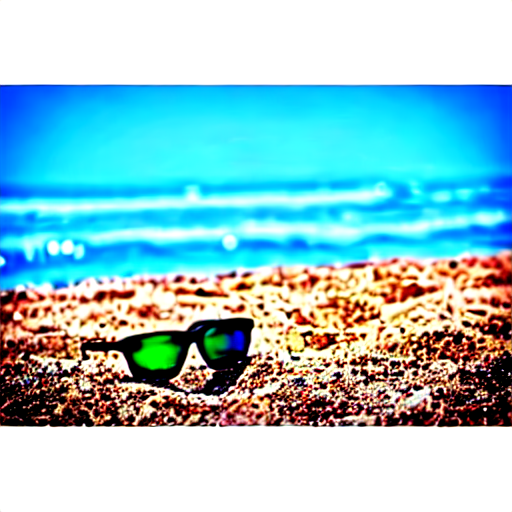

Image: 000000058 Prompt: Transform the close-up scene of the red flower into an aesthetic deep space scene with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpur30sbyz.png')


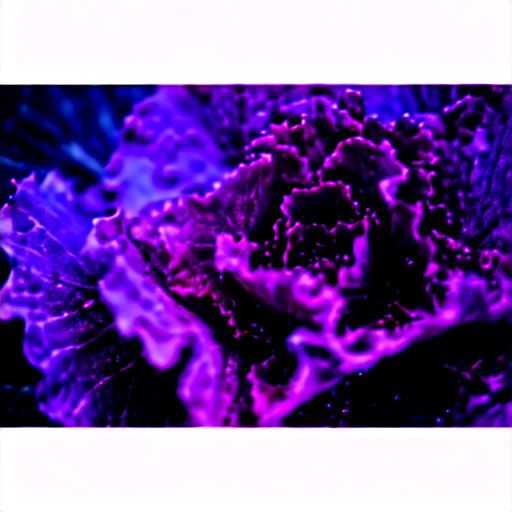

Image: 000000006 Prompt: Convert the scenery of grass and trees into a breathtaking deep space landscape with planets and stars in the background
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp3zhsv70l.png')


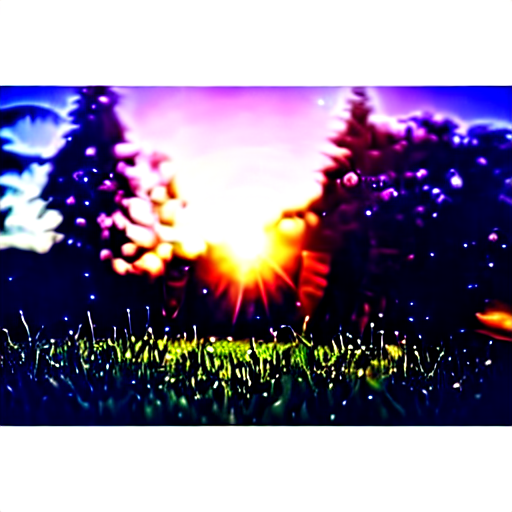

Image: 000000007 Prompt: Transform the scene of a clear body of water during sunset into an aesthetic deep space setting with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp27ozq1bw.png')


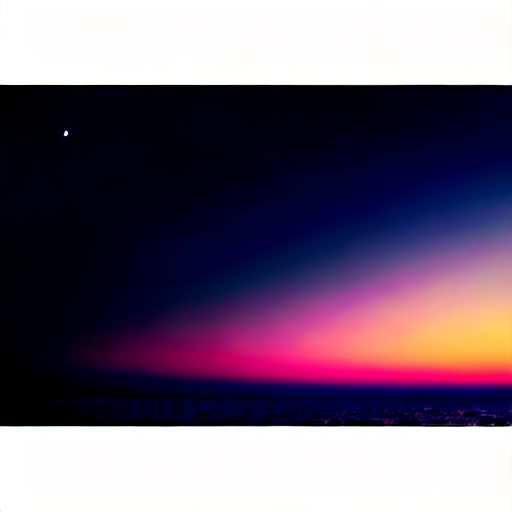

Image: 000000005 Prompt: Place the scene of people riding horses during daytime into a beautiful deep space environment with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp94cccbtr.png')


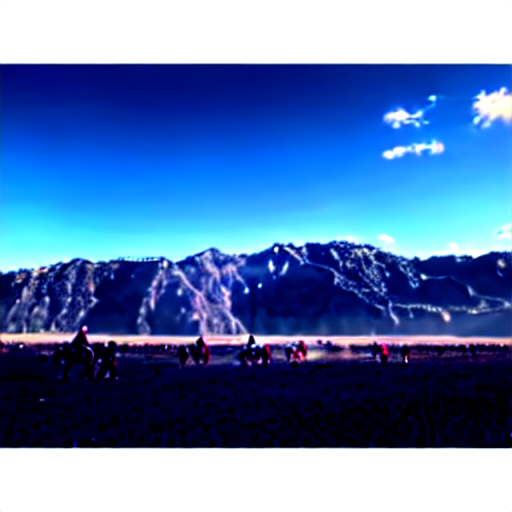

Image: 000000002 Prompt: Transform the scene of the rocky mountain under a gray sky into an aesthetic deep space scene with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpojpvqg3u.png')


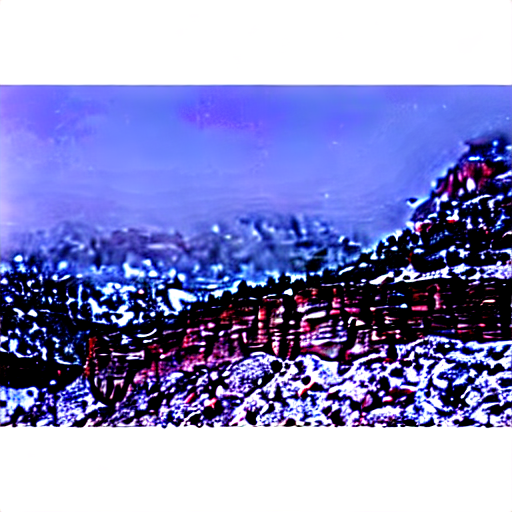

Image: 000000016 Prompt: Place the woman standing on a snow-covered road into an aesthetic deep space environment with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpz5tuvtpu.png')


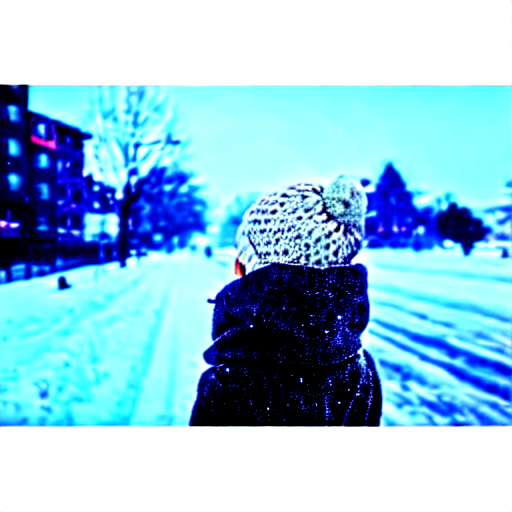

Image: 000000019 Prompt: Surround the squirrel in a deep space environment with planets and stars in the background
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpcfn66dfi.png')


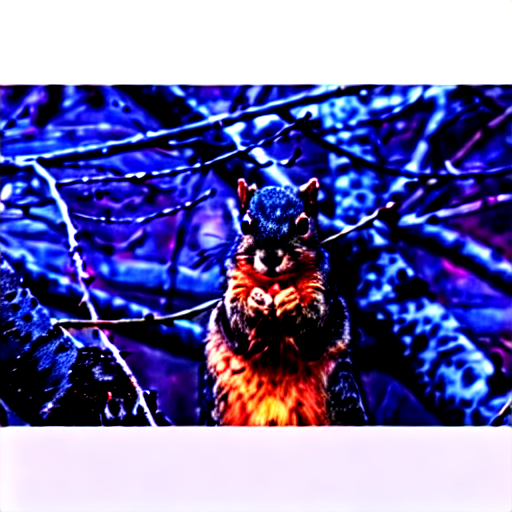

Image: 000000047 Prompt: Set the scene of the pink and white flower in a deep space environment with planets and stars in the background
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp82bjs1u1.png')


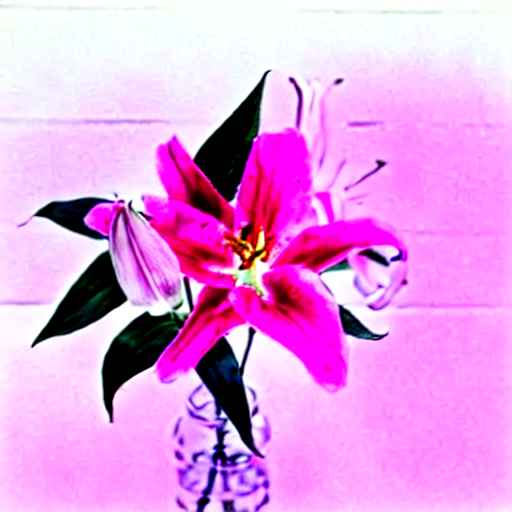

Image: 000000054 Prompt: Place the scene of the brown deer lying on green grass into a surreal deep space environment with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp572agwkz.png')


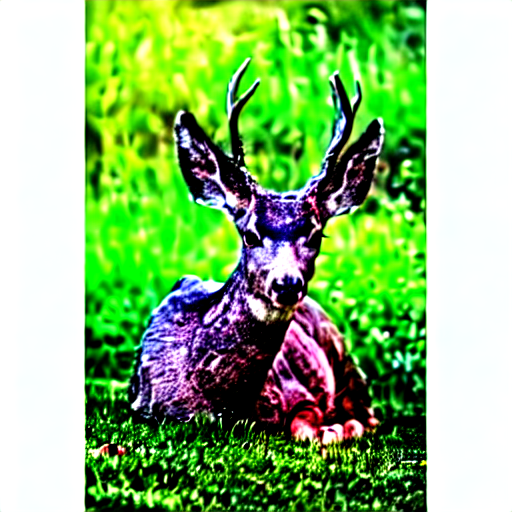

In [37]:
# loop and generate edits, save to file
from IPython.display import Image
from IPython.display import display
for img in images:
    prompt = prompts.get('img_name').get(img).get('prompt')
    print("Image:",img, "Prompt:", prompt)
    image = "../data/out/unplash-512-lite/000_tiny/" + img + ".jpg"
    result = client.predict(
                image,	# str (filepath or URL to image) in 'Input Image' Image component
                prompt,	# str  in 'Edit Instruction' Textbox component
                5,	# int | float  in 'Steps' Number component
                "Fix Seed",	# str  in 'parameter_16' Radio component
                5,	# int | float  in 'Seed' Number component
                "Fix CFG",	# str  in 'parameter_18' Radio component
                5,	# int | float  in 'Text CFG' Number component
                5,	# int | float  in 'Image CFG' Number component
                fn_index=1
    )
    print(result)
    # visualize the image
    display(Image(result[3]))

Image: 000000059 Prompt: Change the scene of the wayfarer sunglasses on beach sand during daytime into a cosmic beach with deep space elements
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpsjjhq2yj.png')


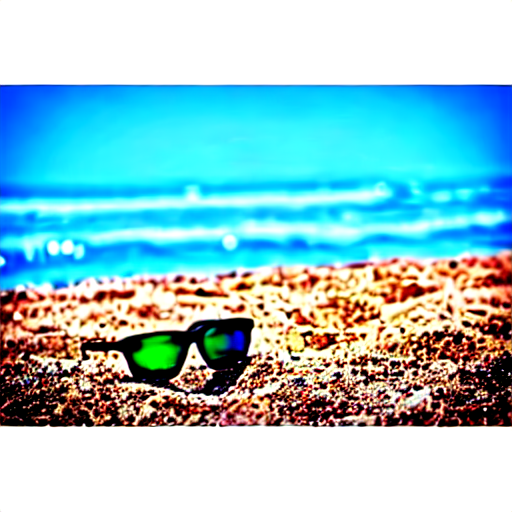

Image: 000000058 Prompt: Transform the close-up scene of the red flower into an aesthetic deep space scene with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpue0osrbd.png')


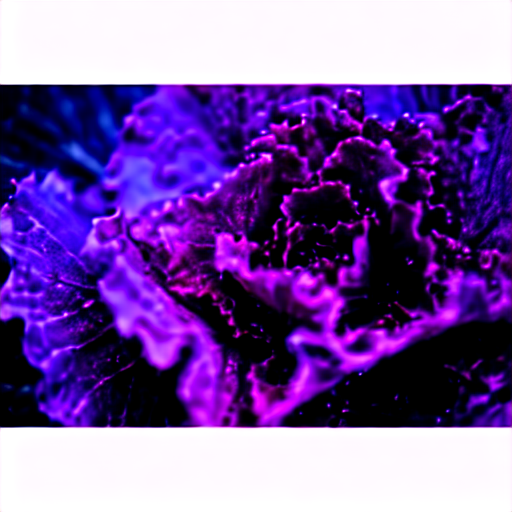

Image: 000000006 Prompt: Convert the scenery of grass and trees into a breathtaking deep space landscape with planets and stars in the background
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp037gt656.png')


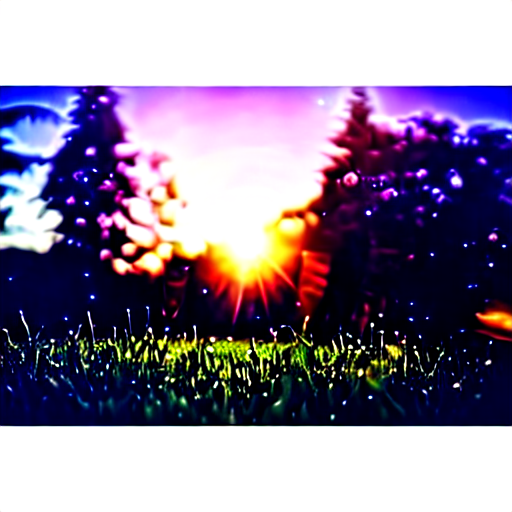

Image: 000000007 Prompt: Transform the scene of a clear body of water during sunset into an aesthetic deep space setting with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp9n64xhn8.png')


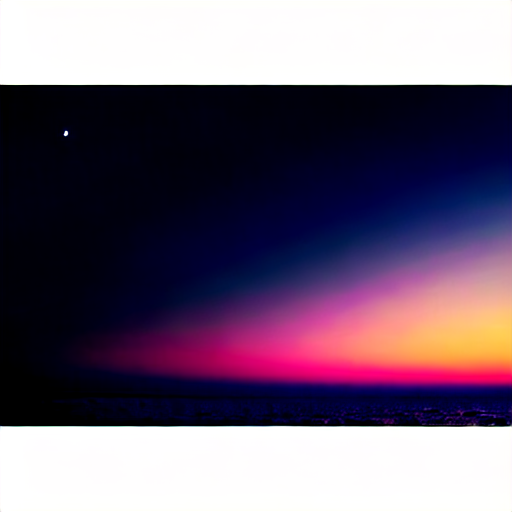

Image: 000000005 Prompt: Place the scene of people riding horses during daytime into a beautiful deep space environment with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpp1i5uyex.png')


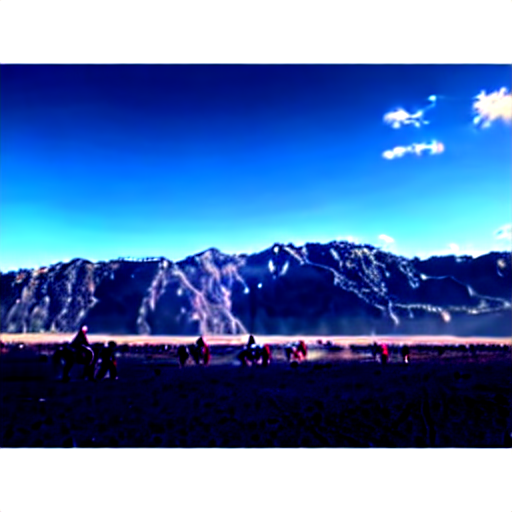

Image: 000000002 Prompt: Transform the scene of the rocky mountain under a gray sky into an aesthetic deep space scene with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpk97qwdze.png')


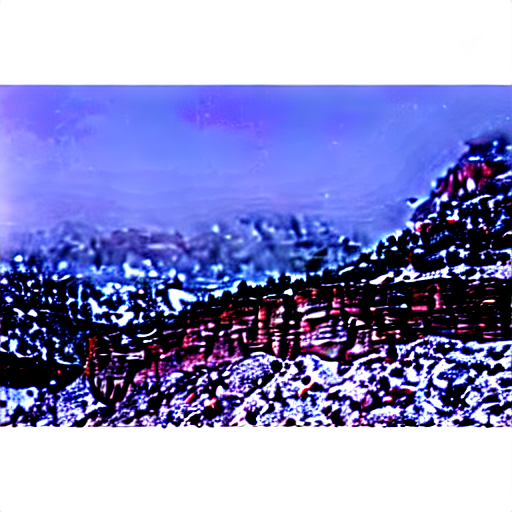

Image: 000000016 Prompt: Place the woman standing on a snow-covered road into an aesthetic deep space environment with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmppl6h81jt.png')


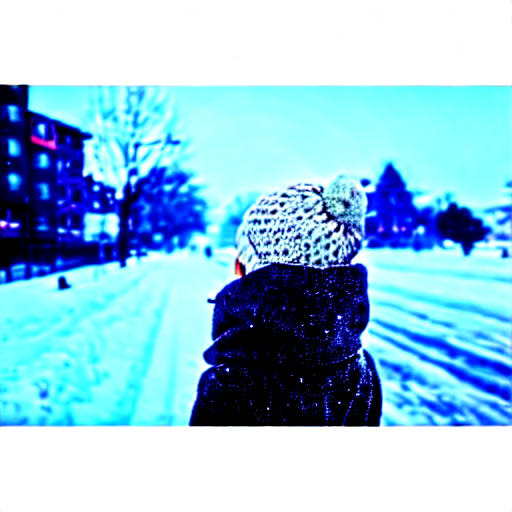

Image: 000000019 Prompt: Surround the squirrel in a deep space environment with planets and stars in the background
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpk0qr8d1c.png')


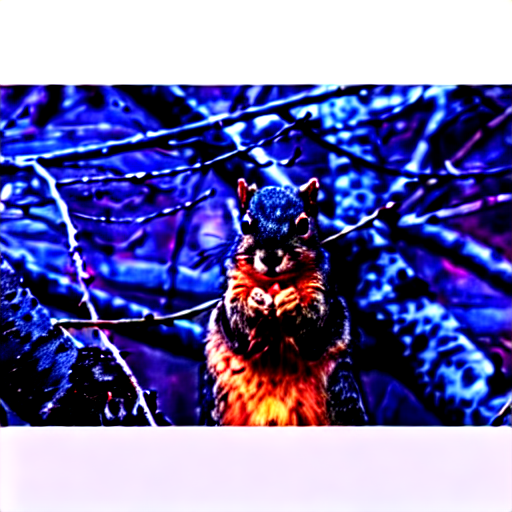

Image: 000000047 Prompt: Set the scene of the pink and white flower in a deep space environment with planets and stars in the background
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpk64_qlmt.png')


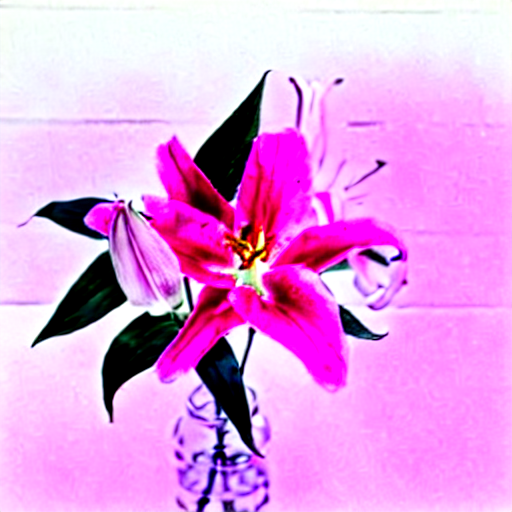

Image: 000000054 Prompt: Place the scene of the brown deer lying on green grass into a surreal deep space environment with planets and stars
(5, 5.0, 5.0, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpi0xy9iht.png')


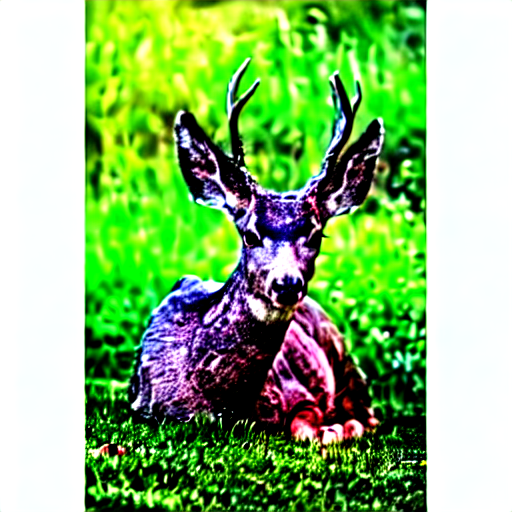

In [38]:
# loop and generate edits, save to file
from IPython.display import display
from PIL import Image
for img in images:
    prompt = prompts.get('img_name').get(img).get('prompt')
    print("Image:",img, "Prompt:", prompt)
    image = "../data/out/unplash-512-lite/000_tiny/" + img + ".jpg"
    result = client.predict(
                image,	# str (filepath or URL to image) in 'Input Image' Image component
                prompt,	# str  in 'Edit Instruction' Textbox component
                5,	# int | float  in 'Steps' Number component
                "Fix Seed",	# str  in 'parameter_16' Radio component
                5,	# int | float  in 'Seed' Number component
                "Fix CFG",	# str  in 'parameter_18' Radio component
                5,	# int | float  in 'Text CFG' Number component
                5,	# int | float  in 'Image CFG' Number component
                fn_index=1
    )
    print(result)
    # visualize the image
    display(Image.open(result[3]))
    Image.open(result[3]).save("../data/out/unplash-512-lite/000_tiny_spacewarp/" + img + ".jpg")


Image: 000000059 Prompt: Change the scene of the wayfarer sunglasses on beach sand during daytime into a cosmic beach with deep space elements
(45689, 7.5, 1.6, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp9fpz4lhi.png')


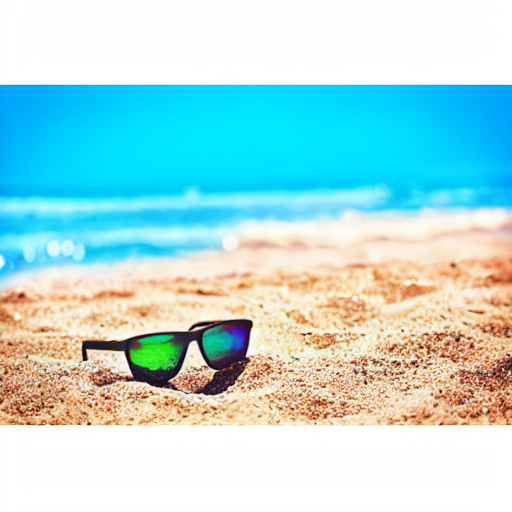

Image: 000000058 Prompt: Transform the close-up scene of the red flower into an aesthetic deep space scene with planets and stars
(32945, 7.5, 1.6, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpajn5v_xh.png')


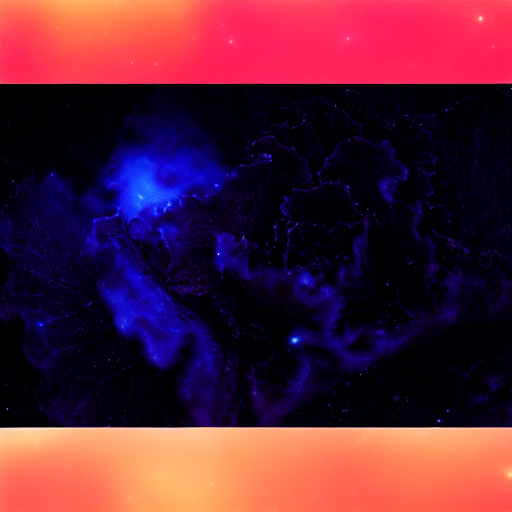

Image: 000000006 Prompt: Convert the scenery of grass and trees into a breathtaking deep space landscape with planets and stars in the background
(55080, 7.5, 1.6, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpu4me9lo_.png')


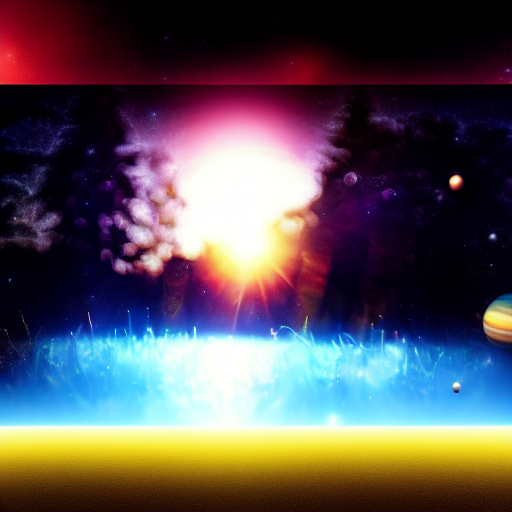

Image: 000000007 Prompt: Transform the scene of a clear body of water during sunset into an aesthetic deep space setting with planets and stars
(49643, 7.5, 1.6, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpqq0vitoo.png')


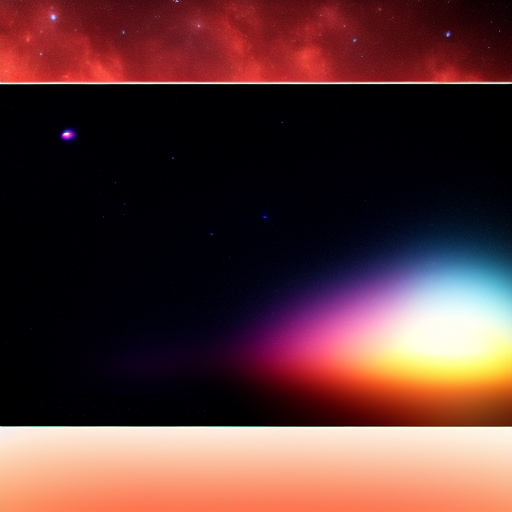

Image: 000000005 Prompt: Place the scene of people riding horses during daytime into a beautiful deep space environment with planets and stars
(30936, 7.5, 1.6, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp6ewcy6_2.png')


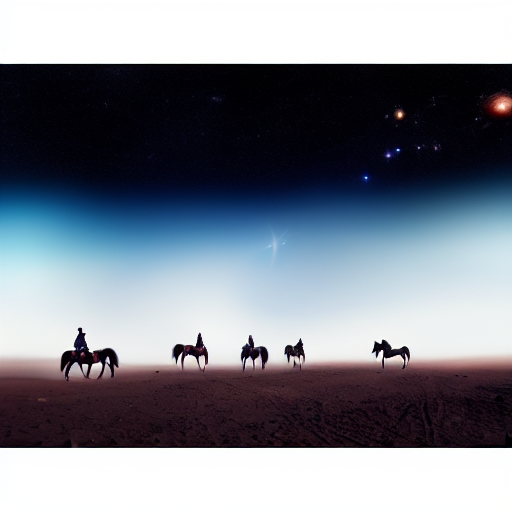

Image: 000000002 Prompt: Transform the scene of the rocky mountain under a gray sky into an aesthetic deep space scene with planets and stars
(80041, 7.5, 1.6, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpfw5l487j.png')


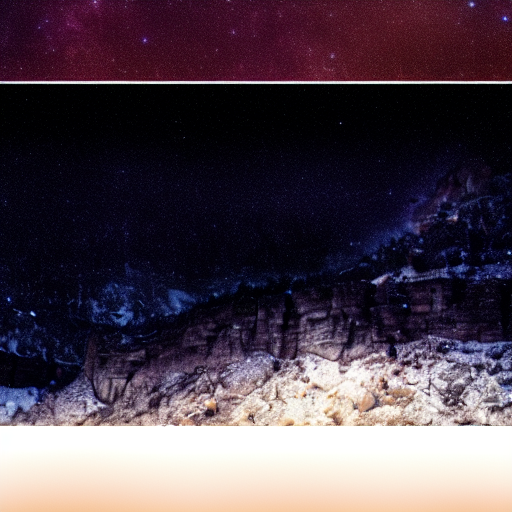

Image: 000000016 Prompt: Place the woman standing on a snow-covered road into an aesthetic deep space environment with planets and stars
(91559, 7.5, 1.6, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmplw8hettg.png')


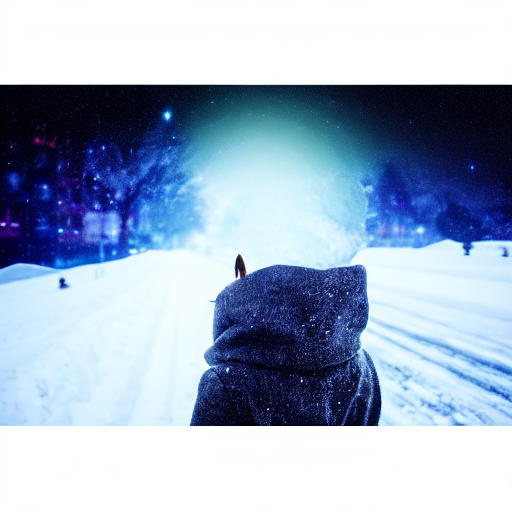

Image: 000000019 Prompt: Surround the squirrel in a deep space environment with planets and stars in the background
(69070, 7.5, 1.6, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpiam0i1a_.png')


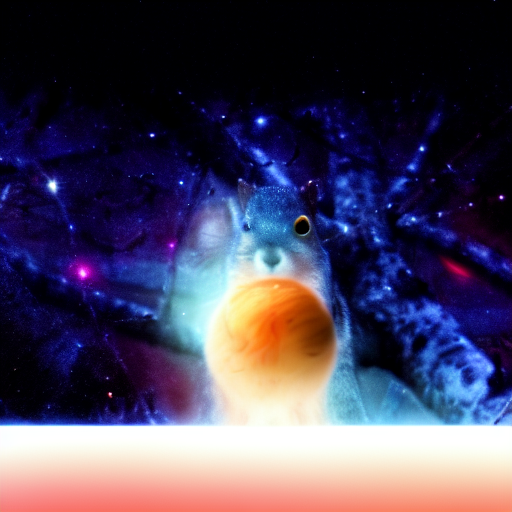

Image: 000000047 Prompt: Set the scene of the pink and white flower in a deep space environment with planets and stars in the background
(43664, 7.5, 1.6, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpt8a24jp5.png')


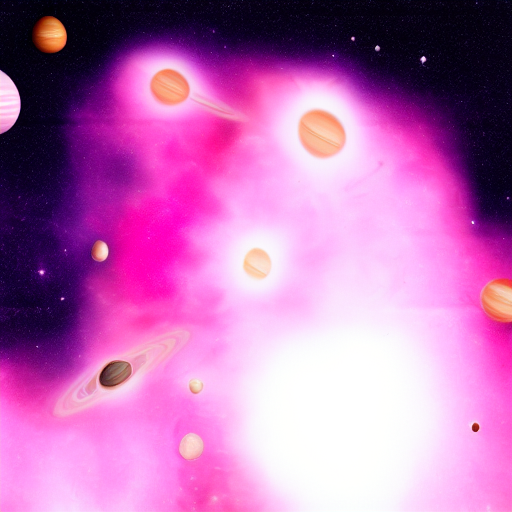

Image: 000000054 Prompt: Place the scene of the brown deer lying on green grass into a surreal deep space environment with planets and stars
(54920, 7.5, 1.6, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpk69a94sj.png')


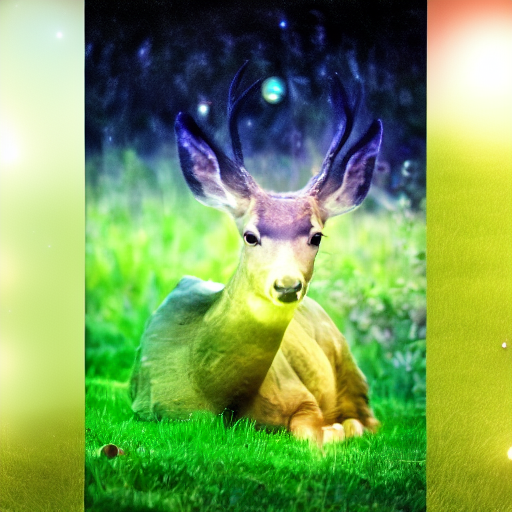

In [39]:
# now with good params
# loop and generate edits, save to file
from IPython.display import display
from PIL import Image
for img in images:
    prompt = prompts.get('img_name').get(img).get('prompt')
    print("Image:",img, "Prompt:", prompt)
    image = "../data/out/unplash-512-lite/000_tiny/" + img + ".jpg"
    result = client.predict(
                image,	# str (filepath or URL to image) in 'Input Image' Image component
                prompt,	# str  in 'Edit Instruction' Textbox component
                25,	# int | float  in 'Steps' Number component
                "Randomize Seed",	# str  in 'parameter_16' Radio component
                -1,	# int | float  in 'Seed' Number component
                "Fix CFG",	# str  in 'parameter_18' Radio component
                7.5,	# int | float  in 'Text CFG' Number component
                1.6,	# int | float  in 'Image CFG' Number component
                fn_index=1
    )
    print(result)
    # visualize the image
    display(Image.open(result[3]))
    Image.open(result[3]).save("../data/out/unplash-512-lite/000_tiny_spacewarp/" + img + ".jpg")

Image: 000000059 Prompt: Change the scene of the wayfarer sunglasses on beach sand during daytime into a cosmic beach with deep space elements
(473, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp2r879300.png')


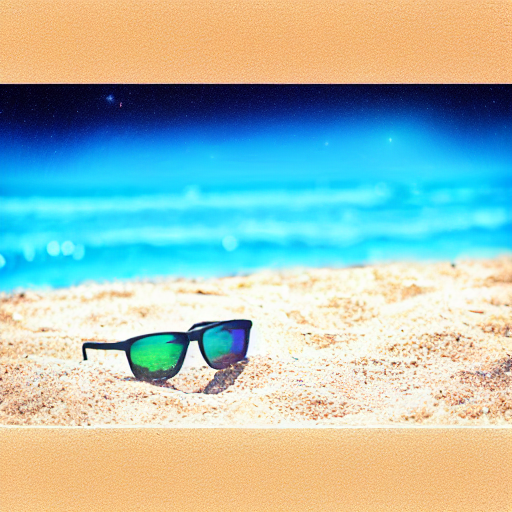

Image: 000000058 Prompt: Transform the close-up scene of the red flower into an aesthetic deep space scene with planets and stars
(22431, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpx8tkxmfk.png')


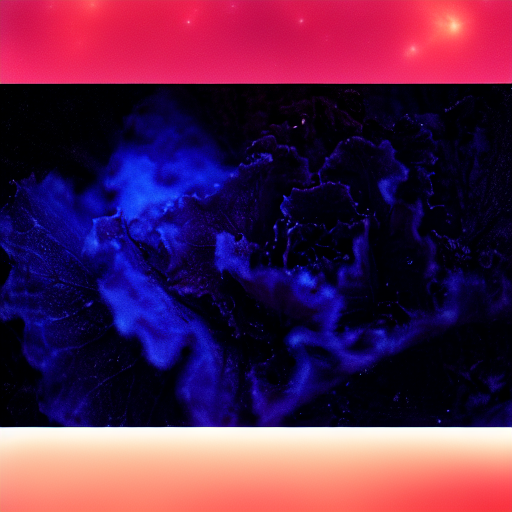

Image: 000000006 Prompt: Convert the scenery of grass and trees into a breathtaking deep space landscape with planets and stars in the background
(80809, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpf0_dv1au.png')


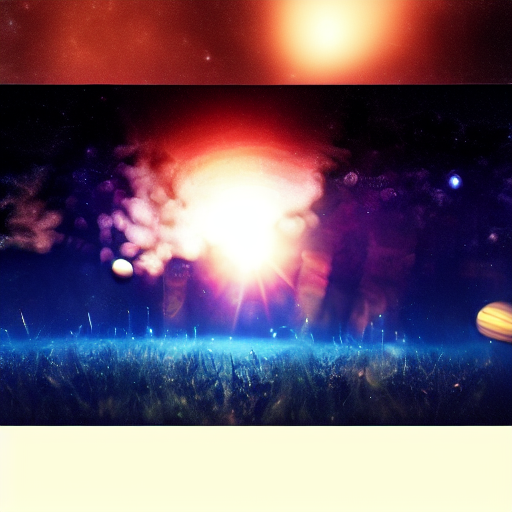

Image: 000000007 Prompt: Transform the scene of a clear body of water during sunset into an aesthetic deep space setting with planets and stars
(93102, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpqwlrk6p_.png')


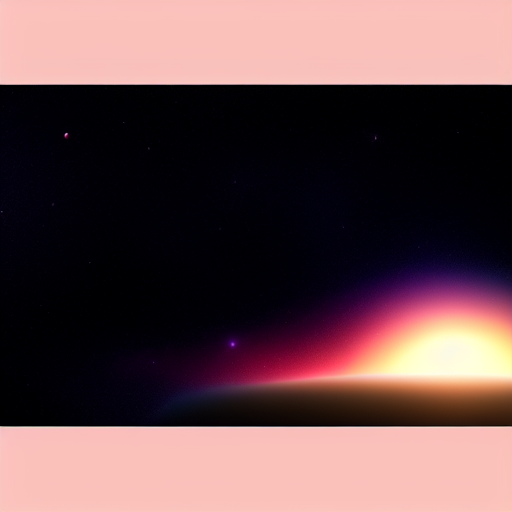

Image: 000000005 Prompt: Place the scene of people riding horses during daytime into a beautiful deep space environment with planets and stars
(97014, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpuqrnte91.png')


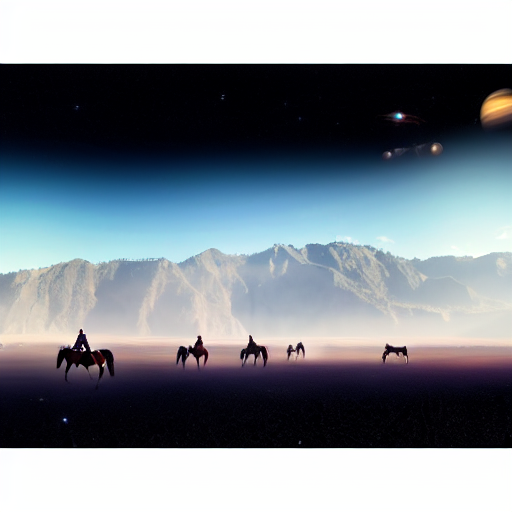

Image: 000000002 Prompt: Transform the scene of the rocky mountain under a gray sky into an aesthetic deep space scene with planets and stars
(50068, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpgnrikkl_.png')


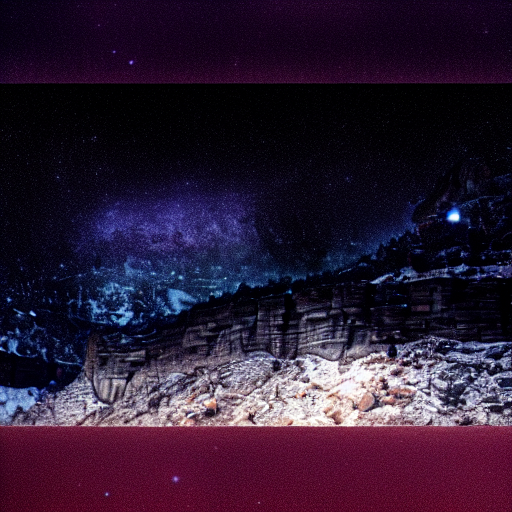

Image: 000000016 Prompt: Place the woman standing on a snow-covered road into an aesthetic deep space environment with planets and stars
(18395, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpk4zzspj3.png')


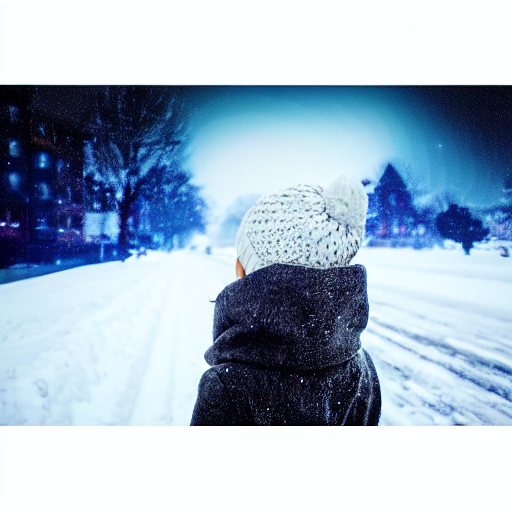

Image: 000000019 Prompt: Surround the squirrel in a deep space environment with planets and stars in the background
(8322, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpxb7jjjjv.png')


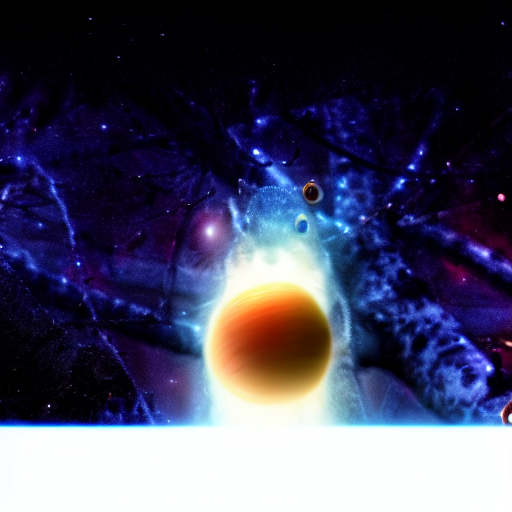

Image: 000000047 Prompt: Set the scene of the pink and white flower in a deep space environment with planets and stars in the background
(51627, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpnhz_ovy0.png')


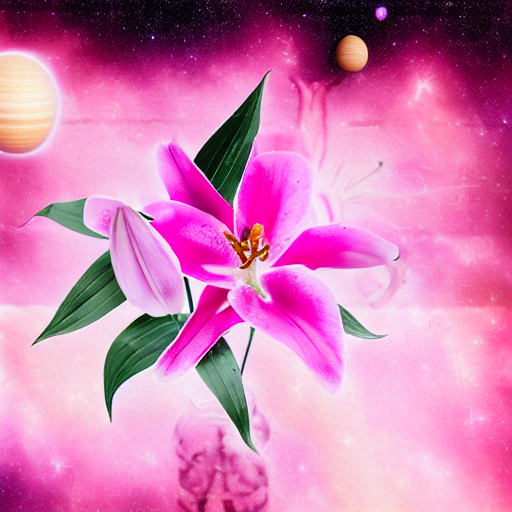

Image: 000000054 Prompt: Place the scene of the brown deer lying on green grass into a surreal deep space environment with planets and stars
(34551, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp7umrrxqt.png')


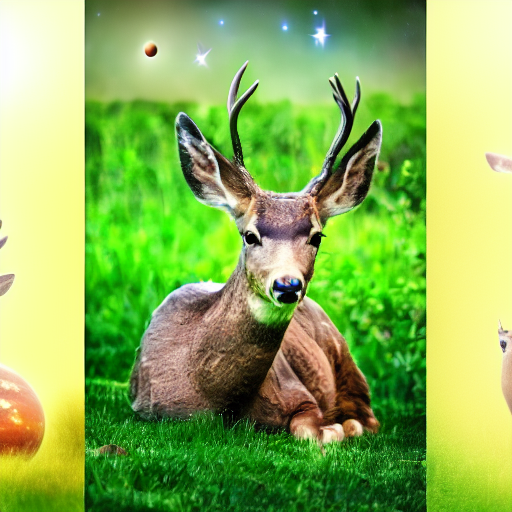

In [40]:
# now with good params
# loop and generate edits, save to file
from IPython.display import display
from PIL import Image
for img in images:
    prompt = prompts.get('img_name').get(img).get('prompt')
    print("Image:",img, "Prompt:", prompt)
    image = "../data/out/unplash-512-lite/000_tiny/" + img + ".jpg"
    result = client.predict(
                image,	# str (filepath or URL to image) in 'Input Image' Image component
                prompt,	# str  in 'Edit Instruction' Textbox component
                25,	# int | float  in 'Steps' Number component
                "Randomize Seed",	# str  in 'parameter_16' Radio component
                -1,	# int | float  in 'Seed' Number component
                "Fix CFG",	# str  in 'parameter_18' Radio component
                7,	# int | float  in 'Text CFG' Number component
                1.65,	# int | float  in 'Image CFG' Number component
                fn_index=1
    )
    print(result)
    # visualize the image
    display(Image.open(result[3]))
    Image.open(result[3]).save("../data/out/unplash-512-lite/000_tiny_spacewarp/" + img + ".jpg")

In [47]:
# # GRADIO CODE from Google Colab Instance:

# #@title Gradio Demo
# from __future__ import annotations

# import math
# import random

# import gradio as gr
# import torch
# from PIL import Image, ImageOps
# from diffusers import StableDiffusionInstructPix2PixPipeline


# help_text = """
# If you're not getting what you want, there may be a few reasons:
# 1. Is the image not changing enough? Your Image CFG weight may be too high. This value dictates how similar the output should be to the input. It's possible your edit requires larger changes from the original image, and your Image CFG weight isn't allowing that. Alternatively, your Text CFG weight may be too low. This value dictates how much to listen to the text instruction. The default Image CFG of 1.5 and Text CFG of 7.5 are a good starting point, but aren't necessarily optimal for each edit. Try:
#     * Decreasing the Image CFG weight, or
#     * Increasing the Text CFG weight, or
# 2. Conversely, is the image changing too much, such that the details in the original image aren't preserved? Try:
#     * Increasing the Image CFG weight, or
#     * Decreasing the Text CFG weight
# 3. Try generating results with different random seeds by setting "Randomize Seed" and running generation multiple times. You can also try setting "Randomize CFG" to sample new Text CFG and Image CFG values each time.
# 4. Rephrasing the instruction sometimes improves results (e.g., "turn him into a dog" vs. "make him a dog" vs. "as a dog").
# 5. Increasing the number of steps sometimes improves results.
# 6. Do faces look weird? The Stable Diffusion autoencoder has a hard time with faces that are small in the image. Try:
#     * Cropping the image so the face takes up a larger portion of the frame.
# """


# example_instructions = [
#     "Make it a picasso painting",
#     "as if it were by modigliani",
#     "convert to a bronze statue",
#     "Turn it into an anime.",
#     "have it look like a graphic novel",
#     "make him gain weight",
#     "what would he look like bald?",
#     "Have him smile",
#     "Put him in a cocktail party.",
#     "move him at the beach.",
#     "add dramatic lighting",
#     "Convert to black and white",
#     "What if it were snowing?",
#     "Give him a leather jacket",
#     "Turn him into a cyborg!",
#     "make him wear a beanie",
# ]

# model_id = "timbrooks/instruct-pix2pix"

# def main():
#     pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(model_id, torch_dtype=torch.float16, revision="fp16", safety_checker=None).to("cuda")
#     example_image = Image.open("./example.jpg").convert("RGB")

#     def load_example(
#         steps: int,
#         randomize_seed: bool,
#         seed: int,
#         randomize_cfg: bool,
#         text_cfg_scale: float,
#         image_cfg_scale: float,
#     ):
#         example_instruction = random.choice(example_instructions)
#         return [example_image, example_instruction] + generate(
#             example_image,
#             example_instruction,
#             steps,
#             randomize_seed,
#             seed,
#             randomize_cfg,
#             text_cfg_scale,
#             image_cfg_scale,
#         )

#     def generate(
#         input_image: Image.Image,
#         instruction: str,
#         steps: int,
#         randomize_seed: bool,
#         seed: int,
#         randomize_cfg: bool,
#         text_cfg_scale: float,
#         image_cfg_scale: float,
#     ):
#         seed = random.randint(0, 100000) if randomize_seed else seed
#         text_cfg_scale = round(random.uniform(6.0, 9.0), ndigits=2) if randomize_cfg else text_cfg_scale
#         image_cfg_scale = round(random.uniform(1.2, 1.8), ndigits=2) if randomize_cfg else image_cfg_scale

#         width, height = input_image.size
#         factor = 512 / max(width, height)
#         factor = math.ceil(min(width, height) * factor / 64) * 64 / min(width, height)
#         width = int((width * factor) // 64) * 64
#         height = int((height * factor) // 64) * 64
#         input_image = ImageOps.fit(input_image, (width, height))

#         if instruction == "":
#             return [input_image, seed]

#         generator = torch.manual_seed(seed)
#         edited_image = pipe(
#             instruction, image=input_image,
#             guidance_scale=text_cfg_scale, image_guidance_scale=image_cfg_scale,
#             num_inference_steps=steps, generator=generator,
#         ).images[0]
#         return [seed, text_cfg_scale, image_cfg_scale, edited_image]

#     def reset():
#         return [0, "Randomize Seed", 1371, "Fix CFG", 7.5, 1.5, None]

#     with gr.Blocks() as demo:
#         with gr.Row():
#             with gr.Column(scale=1, min_width=100):
#                 generate_button = gr.Button("Generate")
#             with gr.Column(scale=1, min_width=100):
#                 load_button = gr.Button("Load Example")
#             with gr.Column(scale=1, min_width=100):
#                 reset_button = gr.Button("Reset")
#             with gr.Column(scale=3):
#                 instruction = gr.Textbox(lines=1, label="Edit Instruction", interactive=True)

#         with gr.Row():
#             input_image = gr.Image(label="Input Image", type="pil", interactive=True)
#             edited_image = gr.Image(label=f"Edited Image", type="pil", interactive=False)
#             input_image.style(height=512, width=512)
#             edited_image.style(height=512, width=512)

#         with gr.Row():
#             steps = gr.Number(value=10, precision=0, label="Steps", interactive=True)
#             randomize_seed = gr.Radio(
#                 ["Fix Seed", "Randomize Seed"],
#                 value="Randomize Seed",
#                 type="index",
#                 show_label=False,
#                 interactive=True,
#             )
#             seed = gr.Number(value=1371, precision=0, label="Seed", interactive=True)
#             randomize_cfg = gr.Radio(
#                 ["Fix CFG", "Randomize CFG"],
#                 value="Fix CFG",
#                 type="index",
#                 show_label=False,
#                 interactive=True,
#             )
#             text_cfg_scale = gr.Number(value=7.5, label=f"Text CFG", interactive=True)
#             image_cfg_scale = gr.Number(value=1.5, label=f"Image CFG", interactive=True)

#         gr.Markdown(help_text)

#         load_button.click(
#             fn=load_example,
#             inputs=[
#                 steps,
#                 randomize_seed,
#                 seed,
#                 randomize_cfg,
#                 text_cfg_scale,
#                 image_cfg_scale,
#             ],
#             outputs=[input_image, instruction, seed, text_cfg_scale, image_cfg_scale, edited_image],
#         )
#         generate_button.click(
#             fn=generate,
#             inputs=[
#                 input_image,
#                 instruction,
#                 steps,
#                 randomize_seed,
#                 seed,
#                 randomize_cfg,
#                 text_cfg_scale,
#                 image_cfg_scale,
#             ],
#             outputs=[seed, text_cfg_scale, image_cfg_scale, edited_image],
#         )
#         reset_button.click(
#             fn=reset,
#             inputs=[],
#             outputs=[steps, randomize_seed, seed, randomize_cfg, text_cfg_scale, image_cfg_scale, edited_image],
#         )

#     demo.launch(share=True, debug=True)


# if __name__ == "__main__":
#     main()

Loaded as API: https://234da546fed232d57c.gradio.live ✔
Image: 000000059 Prompt: Change the scene of the wayfarer sunglasses on beach sand during daytime into a cosmic beach with deep space elements
(93458, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp_si7fmi0.png')


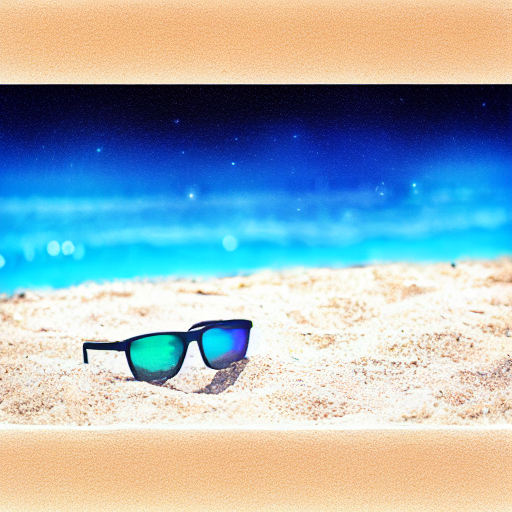

Image: 000000058 Prompt: Transform the close-up scene of the red flower into an aesthetic deep space scene with planets and stars
(78605, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpjt9uqzfm.png')


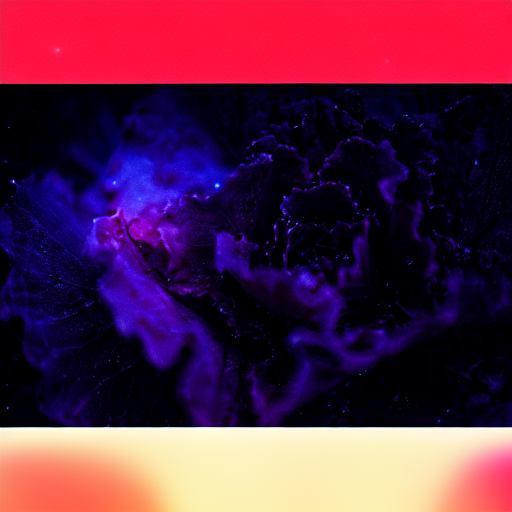

Image: 000000006 Prompt: Convert the scenery of grass and trees into a breathtaking deep space landscape with planets and stars in the background
(50620, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpdftlo8oy.png')


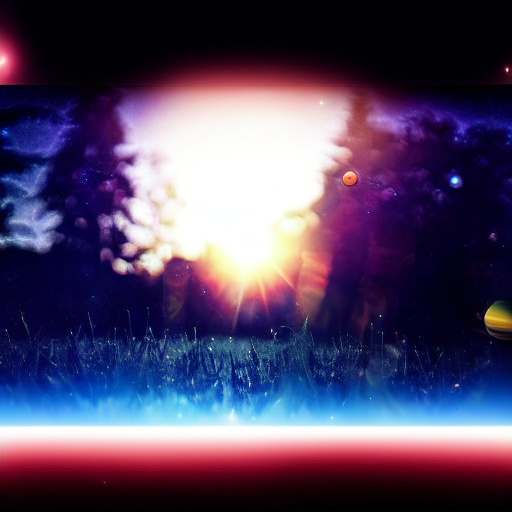

Image: 000000007 Prompt: Transform the scene of a clear body of water during sunset into an aesthetic deep space setting with planets and stars
(61929, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpy_9nz75u.png')


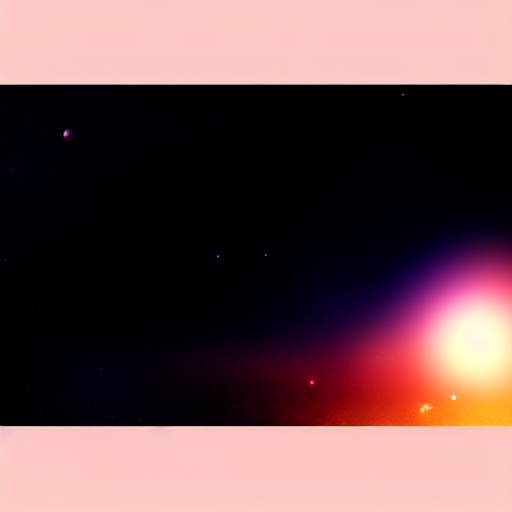

Image: 000000005 Prompt: Place the scene of people riding horses during daytime into a beautiful deep space environment with planets and stars
(41897, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp88tsc4x5.png')


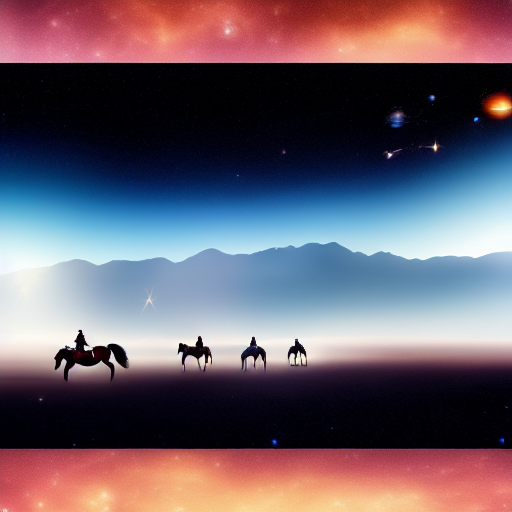

Image: 000000002 Prompt: Transform the scene of the rocky mountain under a gray sky into an aesthetic deep space scene with planets and stars
(62104, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpim3uls_d.png')


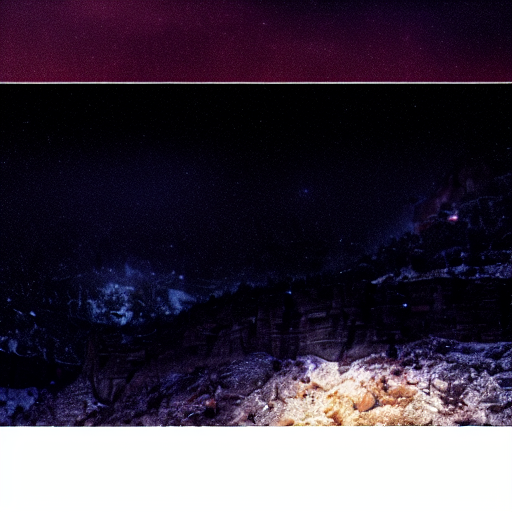

Image: 000000016 Prompt: Place the woman standing on a snow-covered road into an aesthetic deep space environment with planets and stars
(74697, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp1eba3kfn.png')


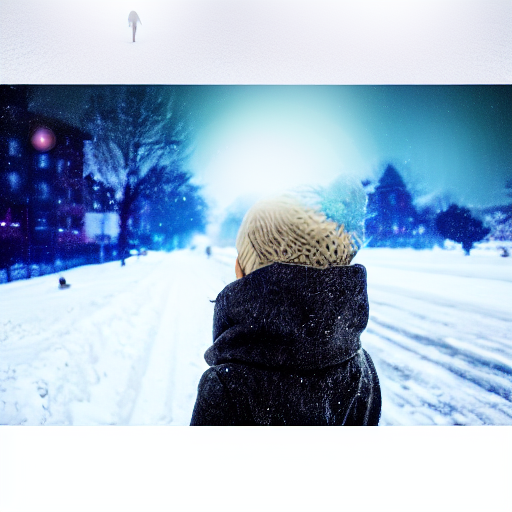

Image: 000000019 Prompt: Surround the squirrel in a deep space environment with planets and stars in the background
(5648, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp99hecvmg.png')


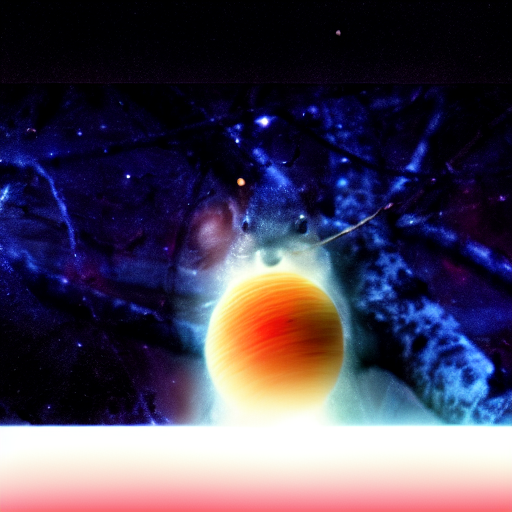

Image: 000000047 Prompt: Set the scene of the pink and white flower in a deep space environment with planets and stars in the background
(59937, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpmch70r7l.png')


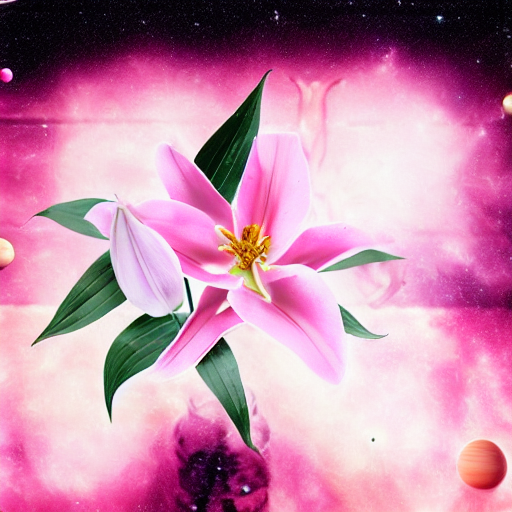

Image: 000000054 Prompt: Place the scene of the brown deer lying on green grass into a surreal deep space environment with planets and stars
(55010, 7.0, 1.65, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmprvqtkscv.png')


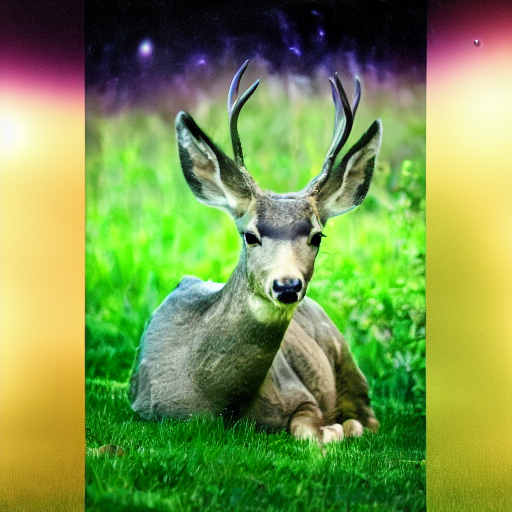

In [48]:
# now with good params
# loop and generate edits, save to file
from IPython.display import display
from PIL import Image
from gradio_client import Client

client = Client("https://234da546fed232d57c.gradio.live")
for img in images:
    prompt = prompts.get('img_name').get(img).get('prompt')
    print("Image:",img, "Prompt:", prompt)
    image = "../data/out/unplash-512-lite/000_tiny/" + img + ".jpg"
    result = client.predict(
                image,	# str (filepath or URL to image) in 'Input Image' Image component
                prompt,	# str  in 'Edit Instruction' Textbox component
                25,	# int | float  in 'Steps' Number component
                "Randomize Seed",	# str  in 'parameter_16' Radio component
                -1,	# int | float  in 'Seed' Number component
                "Fix CFG",	# str  in 'parameter_18' Radio component
                7,	# int | float  in 'Text CFG' Number component
                1.65,	# int | float  in 'Image CFG' Number component
                fn_index=1
    )
    print(result)
    # visualize the image
    display(Image.open(result[3]))
    Image.open(result[3]).save("../data/out/unplash-512-lite/000_tiny_spacewarp_1/" + img + ".jpg")

Loaded as API: https://566177df4e82e0cc0e.gradio.live ✔
Image: 000000059 Prompt: Change the scene of the wayfarer sunglasses on beach sand during daytime into a cosmic beach with deep space elements
(67944, 7.0, 1.75, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpbihfsp2o.png')


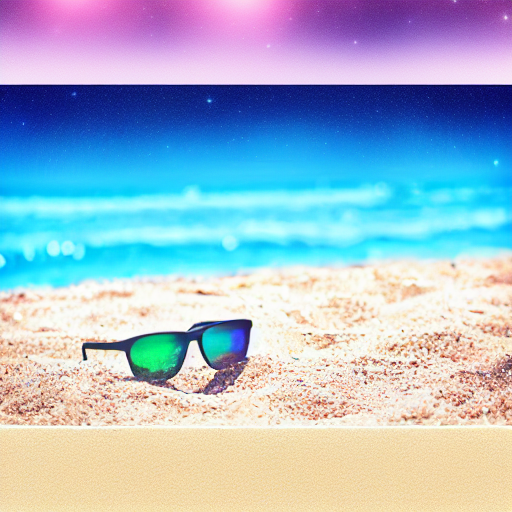

Image: 000000058 Prompt: Transform the close-up scene of the red flower into an aesthetic deep space scene with planets and stars
(31209, 7.0, 1.75, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp4thwsrwf.png')


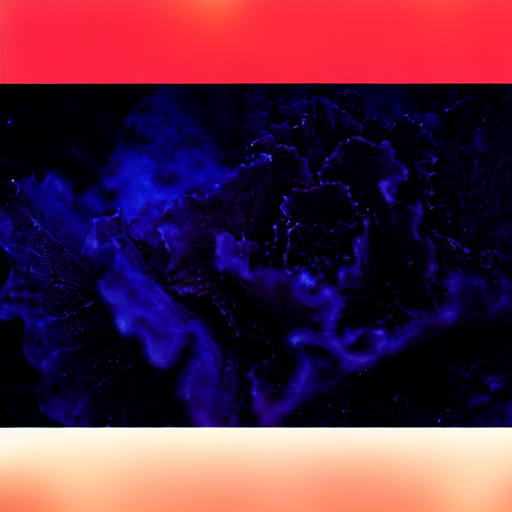

Image: 000000006 Prompt: Convert the scenery of grass and trees into a breathtaking deep space landscape with planets and stars in the background
(18748, 7.0, 1.75, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmppies2el6.png')


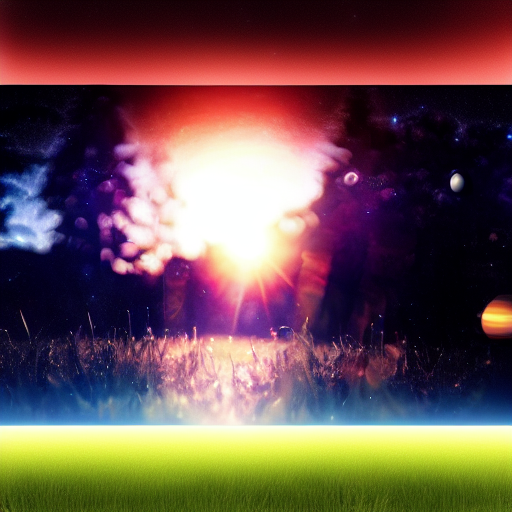

Image: 000000007 Prompt: Transform the scene of a clear body of water during sunset into an aesthetic deep space setting with planets and stars
(41384, 7.0, 1.75, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpab9nf6gm.png')


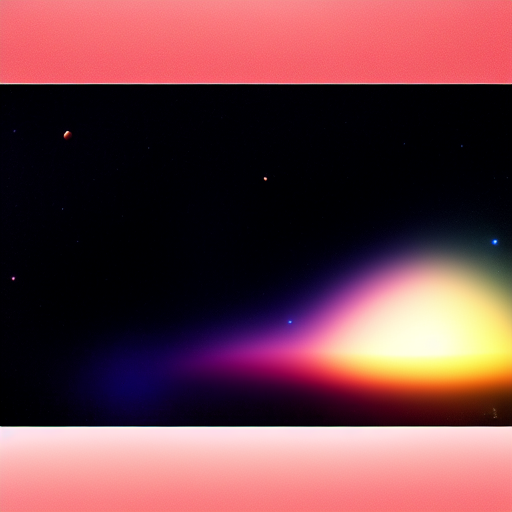

Image: 000000005 Prompt: Place the scene of people riding horses during daytime into a beautiful deep space environment with planets and stars
(95164, 7.0, 1.75, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmphz04ktca.png')


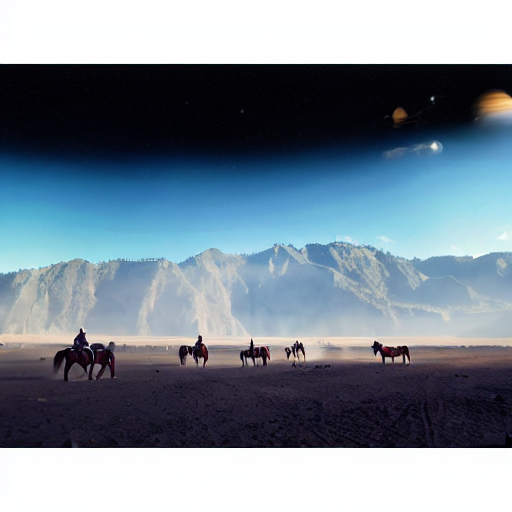

Image: 000000002 Prompt: Transform the scene of the rocky mountain under a gray sky into an aesthetic deep space scene with planets and stars
(27249, 7.0, 1.75, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpunha5t0v.png')


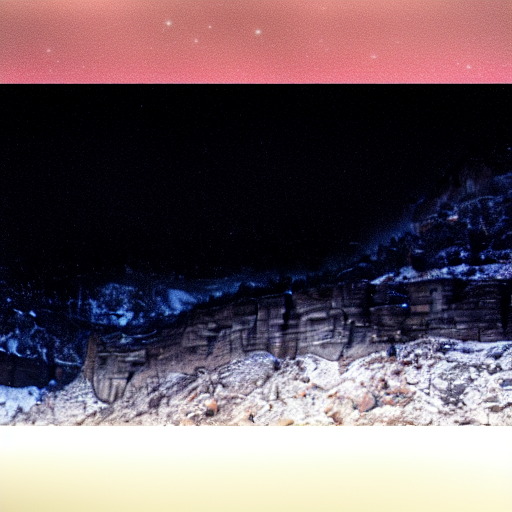

Image: 000000016 Prompt: Place the woman standing on a snow-covered road into an aesthetic deep space environment with planets and stars
(49730, 7.0, 1.75, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpwwfd8mwl.png')


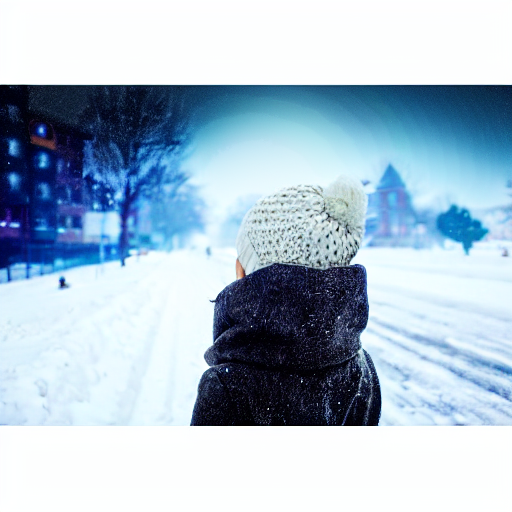

Image: 000000019 Prompt: Surround the squirrel in a deep space environment with planets and stars in the background
(84897, 7.0, 1.75, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpr9dbw3xf.png')


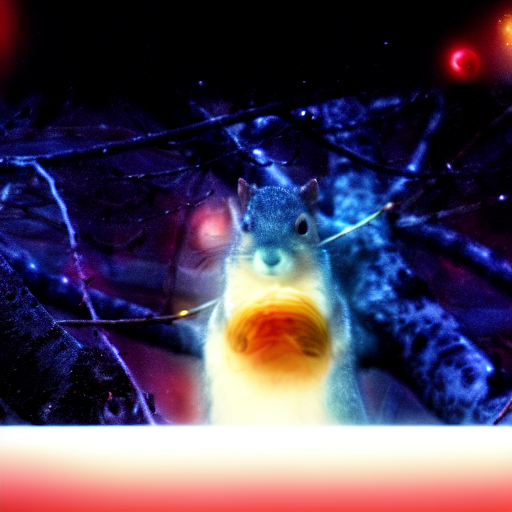

Image: 000000047 Prompt: Set the scene of the pink and white flower in a deep space environment with planets and stars in the background
(73567, 7.0, 1.75, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmp3z6m2_23.png')


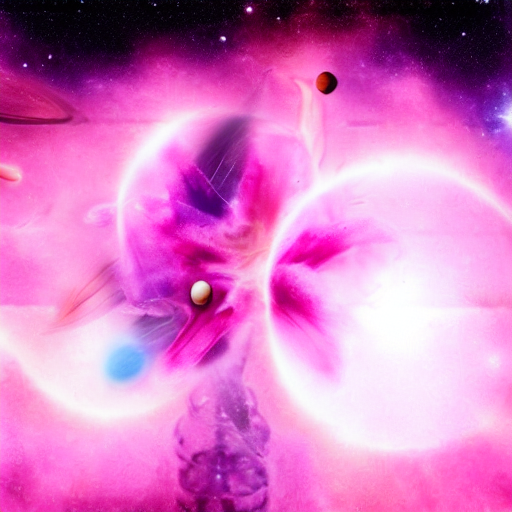

Image: 000000054 Prompt: Place the scene of the brown deer lying on green grass into a surreal deep space environment with planets and stars
(20885, 7.0, 1.75, '/var/folders/lk/60pqr7fj1bd13wyw3nwdcbb80000gn/T/tmpmmuiqmq1.png')


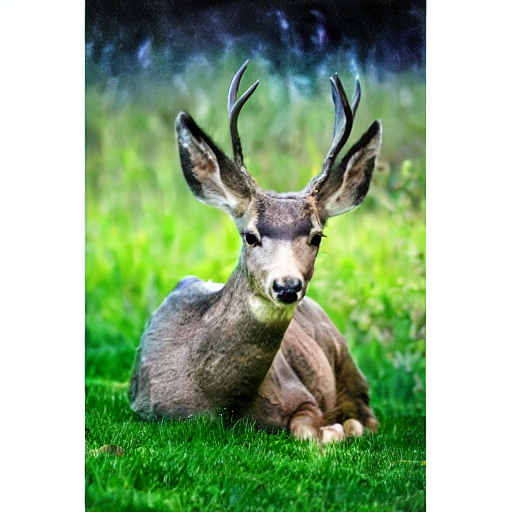

In [50]:
# now with good params
# loop and generate edits, save to file
from IPython.display import display
from PIL import Image
from gradio_client import Client

client = Client("https://566177df4e82e0cc0e.gradio.live")
for img in images:
    prompt = prompts.get('img_name').get(img).get('prompt')
    print("Image:",img, "Prompt:", prompt)
    image = "../data/out/unplash-512-lite/000_tiny/" + img + ".jpg"
    result = client.predict(
                image,	# str (filepath or URL to image) in 'Input Image' Image component
                prompt,	# str  in 'Edit Instruction' Textbox component
                20,	# int | float  in 'Steps' Number component
                "Randomize Seed",	# str  in 'parameter_16' Radio component
                -1,	# int | float  in 'Seed' Number component
                "Fix CFG",	# str  in 'parameter_18' Radio component
                7,	# int | float  in 'Text CFG' Number component
                1.75,	# int | float  in 'Image CFG' Number component
                fn_index=1
    )
    print(result)
    # visualize the image
    display(Image.open(result[3]))
    Image.open(result[3]).save("../data/out/unplash-512-lite/000_tiny_spacewarp_1/" + img + ".jpg")

In [56]:
# now with good params
# loop and generate edits, save to file
from IPython.display import display
from PIL import Image
from gradio_client import Client

client = Client("https://4a3428a6db22f5bb10.gradio.live")
for img in images:
    print("Image:",img, "Prompt:", prompt)
    prompt = prompts.get('img_name').get(img).get('prompt')
    image = "../data/out/unplash-512-lite/000_tiny/" + img + ".jpg"
    for i in range(0, 4):
        # recover if it fails, let's not waste time / data / override:
        path = "../data/out/unplash-512-lite/000_tiny_spacewarp_2/"
        name = img + f"_{i}.jpg"
        if os.path.exists(path + name):
            print("Already exists, skipping, no overwrite:", name)
            continue
        result = client.predict(
                    image,	# str (filepath or URL to image) in 'Input Image' Image component
                    prompt,	# str  in 'Edit Instruction' Textbox component
                    25,	# int | float  in 'Steps' Number component
                    "Randomize Seed",	# str  in 'parameter_16' Radio component
                    -1,	# int | float  in 'Seed' Number component
                    "Fix CFG",	# str  in 'parameter_18' Radio component
                    7,	# int | float  in 'Text CFG' Number component
                    1.75,	# int | float  in 'Image CFG' Number component
                    fn_index=1
        )
        print(result)
        # visualize the image
        #display(Image.open(result[3]))
        
        Image.open(result[3]).save("../data/out/unplash-512-lite/000_tiny_spacewarp_2/" + img + f"_{i}.jpg")

Loaded as API: https://4a3428a6db22f5bb10.gradio.live ✔
Image: 000000059 Prompt: Place the scene of the brown deer lying on green grass into a surreal deep space environment with planets and stars
Already exists, skipping, no overwrite: 000000059_0.jpg
Already exists, skipping, no overwrite: 000000059_1.jpg
Already exists, skipping, no overwrite: 000000059_2.jpg
Already exists, skipping, no overwrite: 000000059_3.jpg
Image: 000000058 Prompt: Change the scene of the wayfarer sunglasses on beach sand during daytime into a cosmic beach with deep space elements
Already exists, skipping, no overwrite: 000000058_0.jpg
Already exists, skipping, no overwrite: 000000058_1.jpg
Already exists, skipping, no overwrite: 000000058_2.jpg
Already exists, skipping, no overwrite: 000000058_3.jpg
Image: 000000006 Prompt: Transform the close-up scene of the red flower into an aesthetic deep space scene with planets and stars
Already exists, skipping, no overwrite: 000000006_0.jpg
Already exists, skipping, 

---


In [72]:
# now with good params
# loop and generate edits, save to file
from IPython.display import display
from PIL import Image
from gradio_client import Client

images_path = "../data/out/unplash-512-lite/00000/"
# get jpgs
images = [f for f in os.listdir(images_path) if f.endswith('.jpg')]

images_names = [f.split('.')[0] for f in images]
images_names = [f.split('/')[-1] for f in images_names]
print(images_names[0:10])
# load prompts 
with open('../data/out/unplash-512-lite/000000_image_spacewarp_prompts_gpt4.json') as json_file:
    # json lines
    prompts = json.load(json_file)

print(prompts.get('img_name').get('000000002'))

client = Client("https://fca0a171b7a16340c8.gradio.live")
for img in images_names:
    try:
        prompt = prompts.get('img_name').get(img).get('prompt')
        alternative = prompts.get('img_name').get(img).get('alternative')
    except:
        print("No prompt for image:", img)
        continue
    print("Image:",img, "Prompt:", prompt, "Alternative:", alternative)
    image = images_path + img + ".jpg"
    for i in range(0, 8):
        # recover if it fails, let's not waste time / data / override:
        path = images_path + "spacewarp/"
        name = img + f"_{i}.jpg"
        if os.path.exists(path + name):
            print("Already exists, skipping, no overwrite:", name)
            continue
        if i > 3: # use alternative prompt for 4,5,6,7 
            prompt = alternative
        result = client.predict(
                    image,	# str (filepath or URL to image) in 'Input Image' Image component
                    prompt,	# str  in 'Edit Instruction' Textbox component
                    25,	# int | float  in 'Steps' Number component
                    "Randomize Seed",	# str  in 'parameter_16' Radio component
                    -1,	# int | float  in 'Seed' Number component
                    "Fix CFG",	# str  in 'parameter_18' Radio component
                    7,	# int | float  in 'Text CFG' Number component
                    1.75,	# int | float  in 'Image CFG' Number component
                    fn_index=1
        )
        print(result)
        # visualize the image
        #display(Image.open(result[3]))
        
        Image.open(result[3]).save(path + img + f"_{i}.jpg")

['000005848', '000007087', '000001384', '000006372', '000007044', '000002128', '000007050', '000000059', '000001810', '000006819']
{'description': 'rocky mountain under gray sky at daytime', 'prompt': 'Transform the scene of the rocky mountain under a gray sky at daytime into a rocky mountain under a cosmic sky with galaxies and stars', 'alternative': 'Change the daytime scene of the rocky mountain under a gray sky into a rocky mountain under a starry night sky'}
Loaded as API: https://fca0a171b7a16340c8.gradio.live ✔
No prompt for image: 000005848
No prompt for image: 000007087
No prompt for image: 000001384
No prompt for image: 000006372
No prompt for image: 000007044
No prompt for image: 000002128
No prompt for image: 000007050
Image: 000000059 Prompt: Alter the scene of the wayfarer sunglasses on beach sand during daytime into sunglasses on a cosmic beach with celestial bodies reflected in the lenses Alternative: Change the scene of the wayfarer sunglasses on beach sand during dayt